# Visualize all Cascade Volcanoes

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio as rio
import matplotlib.pyplot as plt
import xarray as xr
from datetime import datetime
import matplotlib
import ipyleaflet
import sys
import os
import dask_gateway
import planetary_computer
sys.path.append('../sar_snowmelt_timing')
import s1_rtc_bs_utils
import contextily as ctx
import rioxarray as rxr
import pathlib
import glob
import re
from matplotlib.pyplot import cm
import scipy
import matplotlib.cm as cm
from matplotlib.colors import Normalize

In [2]:
names = ['MtBaker',
         'GlacierPeak',
         'MtRainier',
         'MtAdams',
         'MtStHelens',
         'MtHood',
         'MtJefferson',
         'ThreeSisters',
         #'CraterLake',
         'MtShasta',
         'LassenPeak',]

geojsons = ['../input/shapefiles/mt_baker.geojson',
            '../input/shapefiles/glacier_peak.geojson',
            '../input/shapefiles/mt_rainier.geojson',
            '../input/shapefiles/mt_adams.geojson',
            '../input/shapefiles/mt_st_helens.geojson',
            '../input/shapefiles/mt_hood.geojson',
            '../input/shapefiles/mt_jefferson.geojson',
            '../input/shapefiles/three_sisters.geojson',
            #'../input/shapefiles/crater_lake.geojson',
            '../input/shapefiles/mt_shasta.geojson',
            '../input/shapefiles/lassen_peak.geojson',]

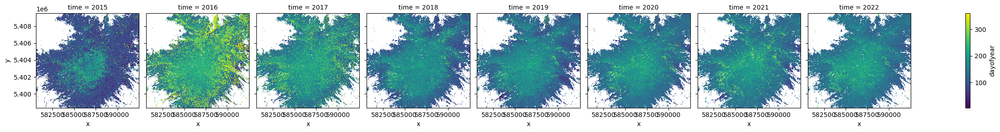

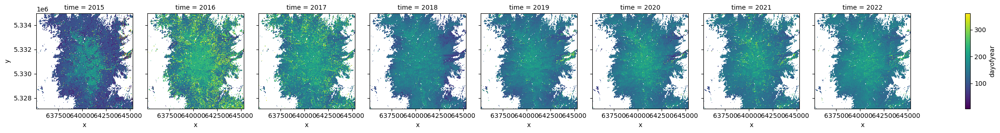

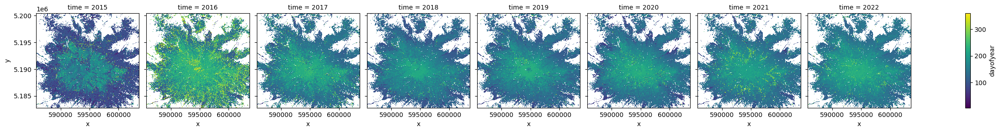

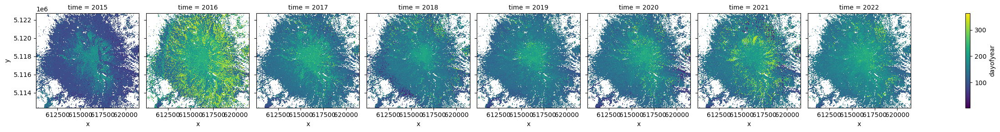

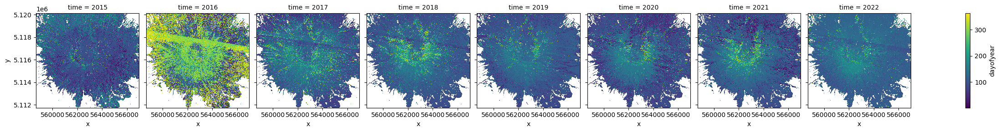

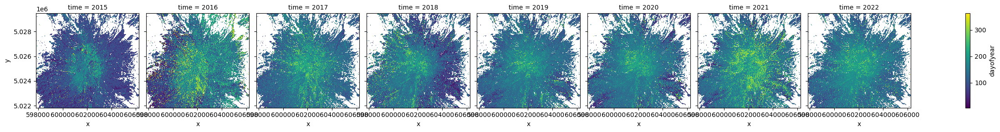

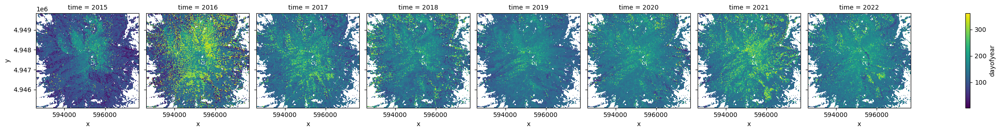

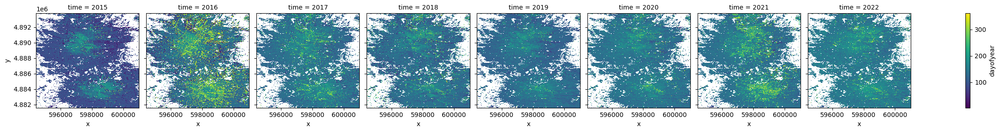

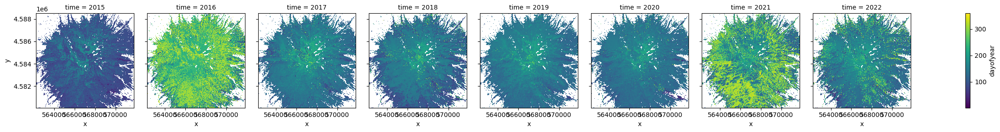

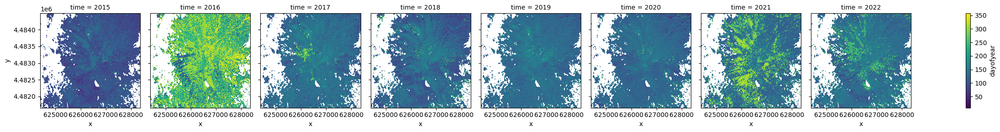

In [3]:
for nm in names:
    geotiff_list = glob.glob(f'../output/cascades/{nm}/runoff_onset_*_2*.tif')
    
    year_list = []
    for geotiff in geotiff_list:
        year_list.append(re.search("([0-9]{4})", geotiff).group(0))
    year_list = [int(year) for year in year_list]

 #Create variable used for time axis
    time_var = xr.Variable('time', year_list)

# Load in and concatenate all individual GeoTIFFs
    runoffs_allyears = xr.concat([rxr.open_rasterio(i) for i in geotiff_list],dim=time_var).squeeze().sortby('time')
    
    runoffs_allyears.plot(col='time')

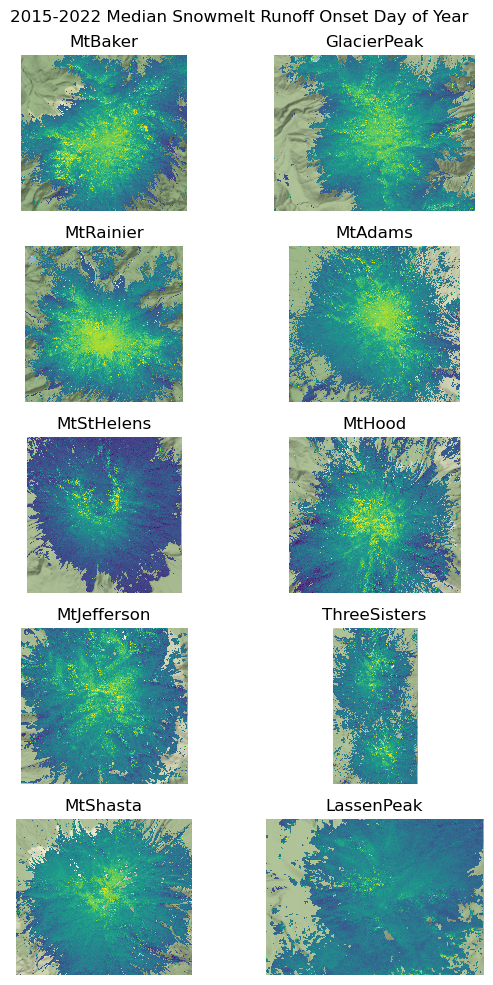

In [4]:
f,ax = plt.subplots(5,2,figsize=(6,10))

for nm,axs in zip(names,ax.ravel()):
    filename = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
    plots = rxr.open_rasterio(filename[0])
    plots.plot(ax=axs,vmin=50,vmax=250,add_colorbar=False)
    axs.set_title(f'{nm}')
    axs.set_aspect('equal')
    axs.set_xlabel('')
    axs.set_ylabel('')
    axs.axis('off')
    ctx.add_basemap(ax=axs, crs=plots.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)
f.suptitle(f'2015-2022 Median Snowmelt Runoff Onset Day of Year')
f.tight_layout()

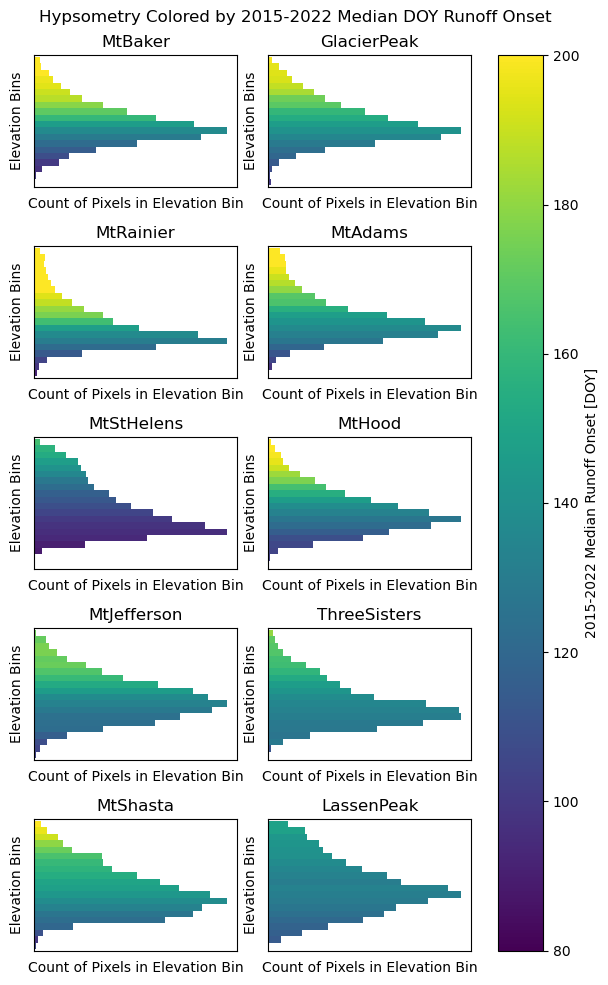

In [13]:
cmap = cm.viridis
norm = Normalize(vmin=80, vmax=200)

f,ax = plt.subplots(5,2,figsize=(6,10))

for nm,axs in zip(names,ax.ravel()):
    filename_median = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
    median_runoff = rxr.open_rasterio(filename_median[0]).squeeze()
    
    filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
    dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(median_runoff>-1)
    
    
    stats_df = pd.DataFrame(columns=['runoff_dates','elevation'])
    stats_df['runoff_dates'] = median_runoff.data.reshape(-1)
    stats_df['elevation'] = dem.data.reshape(-1)
    
    stats_df = stats_df.dropna()
    stats_df.groupby(pd.cut(stats_df["elevation"], 20)).count()['runoff_dates'].plot(ax=axs,kind='barh',width=1,color=cmap(norm(stats_df.groupby(pd.cut(stats_df["elevation"], 20)).median()['runoff_dates'])))
    axs.set_title(f'{nm}')
    axs.set_xticks([]) 
    axs.set_yticks([])
    axs.set_ylabel('Elevation Bins')
    axs.set_xlabel('Count of Pixels in Elevation Bin')
    
f.suptitle(f'Hypsometry Colored by 2015-2022 Median DOY Runoff Onset')
f.tight_layout()
f.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax,label='2015-2022 Median Runoff Onset [DOY]')


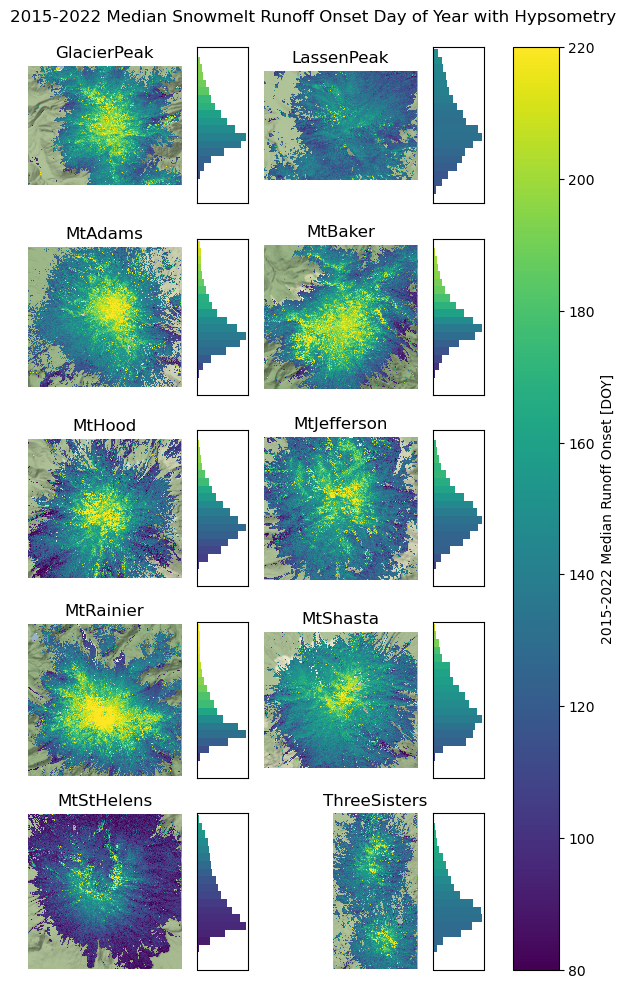

In [37]:
f,ax = plt.subplots(5,4,figsize=(6,10),gridspec_kw={'width_ratios': [3, 1, 3, 1]})

cmap_min = 80
cmap_max = 220


cmap = cm.viridis
norm = Normalize(vmin=cmap_min, vmax=cmap_max)

doublenames = 2*names
doublenames.sort()
for i,(nm,axs) in enumerate(zip(doublenames,ax.ravel())):
    if i % 2 == 0:
        filename = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
        plots = rxr.open_rasterio(filename[0])
        plots.plot(ax=axs,vmin=cmap_min,vmax=cmap_max,add_colorbar=False)
        axs.set_title(f'{nm}')
        axs.set_aspect('equal')
        axs.set_xlabel('')
        axs.set_ylabel('')
        axs.axis('off')
        ctx.add_basemap(ax=axs, crs=plots.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)
    else: 
        filename_median = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
        median_runoff = rxr.open_rasterio(filename_median[0]).squeeze()
    
        filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
        dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(median_runoff>-1)
    
    
        stats_df = pd.DataFrame(columns=['runoff_dates','elevation'])
        stats_df['runoff_dates'] = median_runoff.data.reshape(-1)
        stats_df['elevation'] = dem.data.reshape(-1)
    
        stats_df = stats_df.dropna()
        stats_df.groupby(pd.cut(stats_df["elevation"], 20)).count()['runoff_dates'].plot(ax=axs,kind='barh',width=1,color=cmap(norm(stats_df.groupby(pd.cut(stats_df["elevation"], 20)).median()['runoff_dates'])))
        axs.set_title('')
        axs.set_xticks([]) 
        axs.set_yticks([])
        axs.set_ylabel('')
    
f.suptitle(f'2015-2022 Median Snowmelt Runoff Onset Day of Year with Hypsometry')

f.tight_layout()
f.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax,label='2015-2022 Median Runoff Onset [DOY]')


In [6]:
for nm in names:
    filename_median = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
    median_runoff = rxr.open_rasterio(filename_median[0]).squeeze()
    
    filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
    dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(median_runoff>-1)
    
    filename_aspect = glob.glob(f'../output/cascades/{nm}/*aspect*.tif')
    aspect = rxr.open_rasterio(filename_aspect[0]).squeeze().where(median_runoff>-1)
    
    filename_slope = glob.glob(f'../output/cascades/{nm}/*slope*.tif')
    slope = rxr.open_rasterio(filename_slope[0]).squeeze().where(median_runoff>-1)
    
    stats_df = pd.DataFrame(columns=['runoff_dates','elevation','aspect','slope'])
    stats_df['runoff_dates'] = median_runoff.data.reshape(-1)
    stats_df['elevation'] = dem.data.reshape(-1)
    stats_df['aspect'] = np.cos(np.deg2rad(aspect.data.reshape(-1)))
    stats_df['slope'] = slope.data.reshape(-1)
    stats_df['dah'] = np.cos(np.deg2rad(202.5)-np.deg2rad(aspect.data.reshape(-1)))*np.arctan(np.deg2rad(slope.data.reshape(-1)))
    stats_df = stats_df.dropna()
                 
    predictors = np.append(np.ones_like([stats_df['runoff_dates']]).T,stats_df.loc[:,['elevation']].to_numpy(),axis=1)
    B,_,_,_ = scipy.linalg.lstsq(predictors, stats_df.loc[:,'runoff_dates'])
    print(f'For {nm} during 2015-2022, the average runoff onset date is predicted {B[1]*100:.2f} days later for every 100m of elevation gain.')
    print(stats_df.corr())
    print(f'---------------------------------------------------------------------------------------------------------------------------')

For MtBaker during 2015-2022, the average runoff onset date is predicted 6.15 days later for every 100m of elevation gain.
              runoff_dates  elevation    aspect     slope       dah
runoff_dates      1.000000   0.791621  0.162738  0.098604 -0.137076
elevation         0.791621   1.000000  0.039475  0.113781  0.000104
aspect            0.162738   0.039475  1.000000  0.000335 -0.860765
slope             0.098604   0.113781  0.000335  1.000000  0.012618
dah              -0.137076   0.000104 -0.860765  0.012618  1.000000
---------------------------------------------------------------------------------------------------------------------------
For GlacierPeak during 2015-2022, the average runoff onset date is predicted 5.68 days later for every 100m of elevation gain.
              runoff_dates  elevation    aspect     slope       dah
runoff_dates      1.000000   0.730600  0.203651  0.022802 -0.199144
elevation         0.730600   1.000000 -0.076671  0.018794  0.059215
aspect        

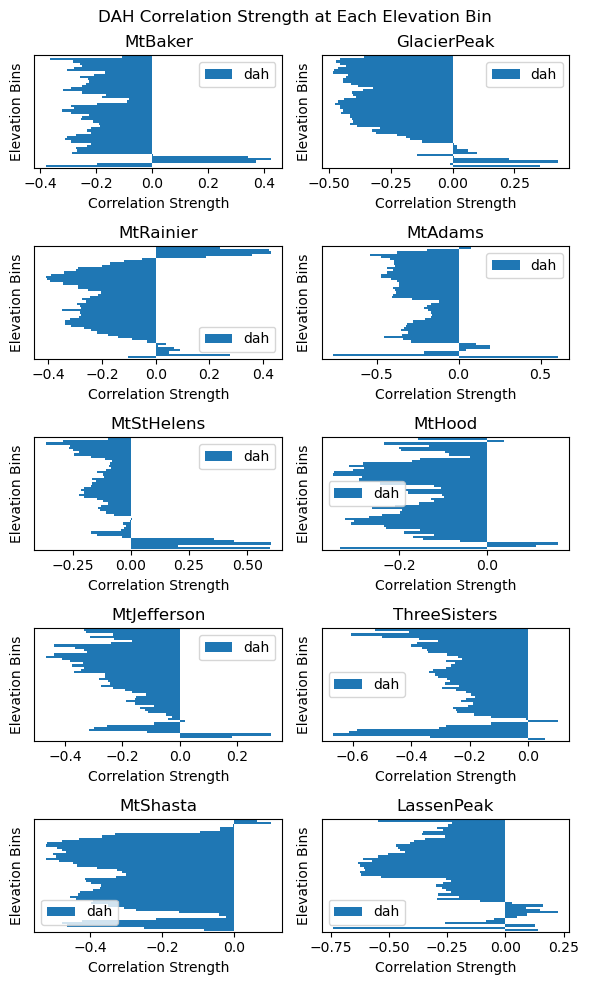

In [7]:
f,ax = plt.subplots(5,2,figsize=(6,10))

for nm,axs in zip(names,ax.ravel()):
    filename_median = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
    median_runoff = rxr.open_rasterio(filename_median[0]).squeeze()
    
    filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
    dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(median_runoff>-1)
    
    filename_aspect = glob.glob(f'../output/cascades/{nm}/*aspect*.tif')
    aspect = rxr.open_rasterio(filename_aspect[0]).squeeze().where(median_runoff>-1)
    
    filename_slope = glob.glob(f'../output/cascades/{nm}/*slope*.tif')
    slope = rxr.open_rasterio(filename_slope[0]).squeeze().where(median_runoff>-1)
    
    stats_df = pd.DataFrame(columns=['runoff_dates','elevation','aspect','slope'])
    stats_df['runoff_dates'] = median_runoff.data.reshape(-1)
    stats_df['elevation'] = dem.data.reshape(-1)
    stats_df['aspect'] = np.cos(np.deg2rad(aspect.data.reshape(-1)))
    stats_df['slope'] = slope.data.reshape(-1)
    stats_df['dah'] = np.cos(np.deg2rad(202.5)-np.deg2rad(aspect.data.reshape(-1)))*np.arctan(np.deg2rad(slope.data.reshape(-1)))
    stats_df = stats_df.dropna()
    
    stats_elevation = stats_df.groupby(pd.cut(stats_df["elevation"], 50)).corr()
    stats_elevation['runoff_dates'].unstack().drop(columns='elevation').drop(columns=['runoff_dates','slope','aspect']).plot(kind='barh',ax=axs,width=1) #.reset_index()
    #stats_df.groupby(pd.cut(stats_df["elevation"], 20)).count()['runoff_dates'].plot(ax=axs,kind='barh',width=1,color=cmap(norm(stats_df.groupby(pd.cut(stats_df["elevation"], 20)).median()['runoff_dates'])))
    axs.set_title(f'{nm}')
    #axs.set_xticks([]) 
    axs.set_yticks([])
    axs.set_ylabel('Elevation Bins')
    axs.set_xlabel('Correlation Strength')
    
f.suptitle(f'DAH Correlation Strength at Each Elevation Bin')
f.tight_layout()

Processing MtBaker...
Processing GlacierPeak...
Processing MtRainier...
Processing MtAdams...
Processing MtStHelens...
Processing MtHood...
Processing MtJefferson...
Processing ThreeSisters...
Processing MtShasta...
Processing LassenPeak...


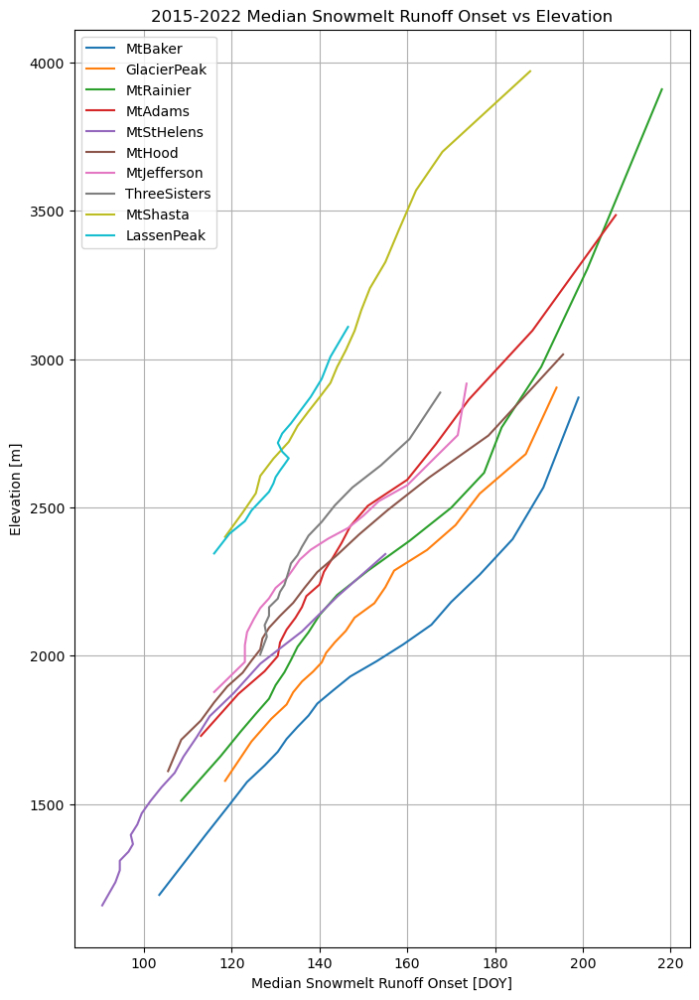

In [8]:
f,ax=plt.subplots(figsize=(8,12))
for nm in names:
    print(f'Processing {nm}...')
    filename_median = glob.glob(f'../output/cascades/{nm}/*allyears_median*.tif')
    median_runoff = rxr.open_rasterio(filename_median[0]).squeeze()
    filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
    dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(median_runoff>-1)
    dem_and_runoff_df = pd.DataFrame((dem.to_numpy().ravel(),median_runoff.to_numpy().ravel())).T.dropna()
    dem_and_runoff_df.columns = ['Elevation','Runoff DOY']

    dem_and_runoff_df.groupby(pd.qcut(dem_and_runoff_df["Elevation"], 20)).median().plot(ax=ax,x='Runoff DOY',y='Elevation',label=f'{nm}')

ax.set_title(f'2015-2022 Median Snowmelt Runoff Onset vs Elevation')
ax.set_xlabel(f'Median Snowmelt Runoff Onset [DOY]')
ax.set_ylabel(f'Elevation [m]')    
ax.grid()

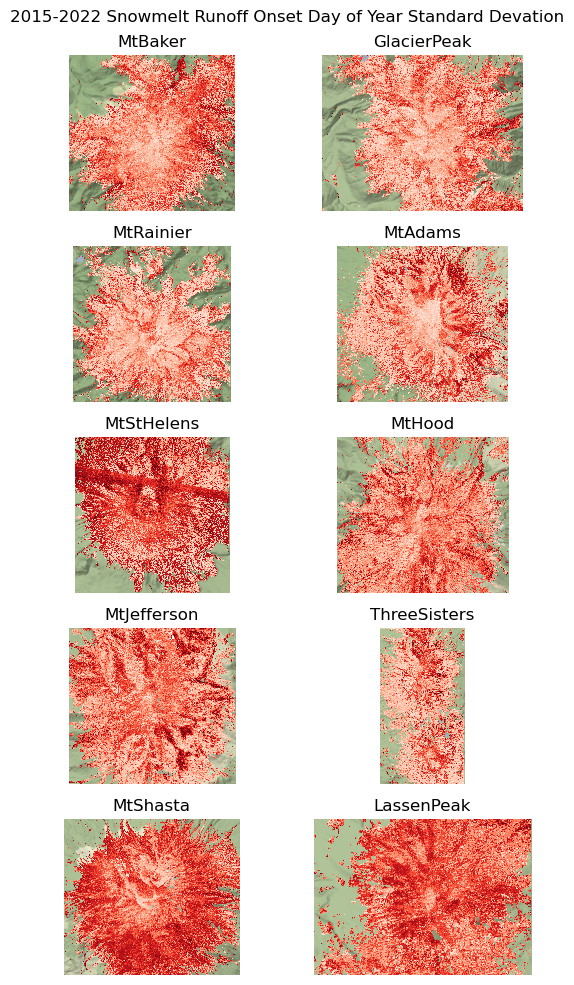

In [9]:
f,ax = plt.subplots(5,2,figsize=(6,10))

for nm,axs in zip(names,ax.ravel()):
    filename = glob.glob(f'../output/cascades/{nm}/*allyears_std*.tif')
    plots = rxr.open_rasterio(filename[0])
    plots.plot(ax=axs,cmap='Reds',vmin=0,vmax=100,add_colorbar=False)
    axs.set_title(f'{nm}')
    axs.set_aspect('equal')
    axs.set_xlabel('')
    axs.set_ylabel('')
    axs.axis('off')
    ctx.add_basemap(ax=axs, crs=plots.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)
f.suptitle(f'2015-2022 Snowmelt Runoff Onset Day of Year Standard Devation')
f.tight_layout()

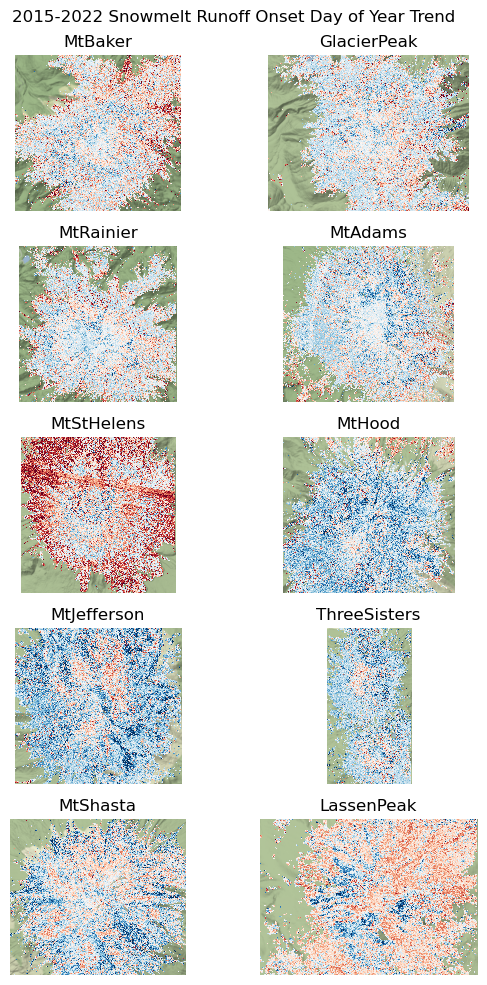

In [10]:
f,ax = plt.subplots(5,2,figsize=(6,10))

for nm,axs in zip(names,ax.ravel()):
    filename = glob.glob(f'../output/cascades/{nm}/*allyears_polyfit*.tif')
    plots = rxr.open_rasterio(filename[0])
    plots.plot(ax=axs,cmap='RdBu',vmin=-20,vmax=20,add_colorbar=False)
    axs.set_title(f'{nm}')
    axs.set_aspect('equal')
    axs.set_xlabel('')
    axs.set_ylabel('')
    axs.axis('off')
    ctx.add_basemap(ax=axs, crs=plots.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)
f.suptitle(f'2015-2022 Snowmelt Runoff Onset Day of Year Trend')
f.tight_layout()

Processing MtBaker...
Processing GlacierPeak...
Processing MtRainier...
Processing MtAdams...
Processing MtStHelens...
Processing MtHood...
Processing MtJefferson...
Processing ThreeSisters...
Processing MtShasta...
Processing LassenPeak...


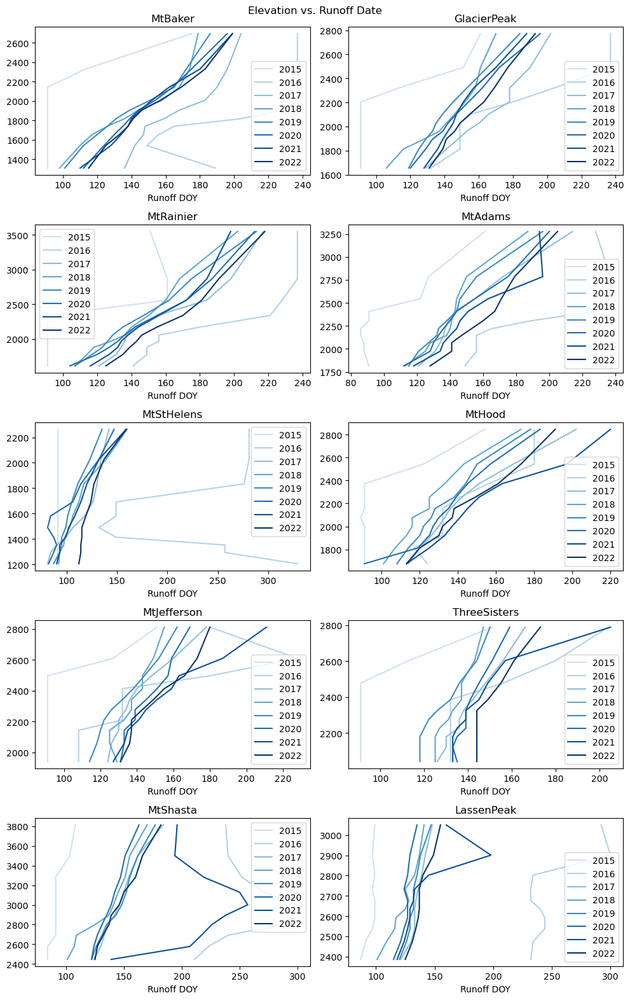

In [11]:
f,ax = plt.subplots(5,2,figsize=(10,16))

for nm,axs in zip(names,ax.ravel()):
    print(f'Processing {nm}...')
    geotiff_list = glob.glob(f'../output/cascades/{nm}/runoff_onset_*_2*.tif')
    year_list = []
    for geotiff in geotiff_list:
        year_list.append(re.search("([0-9]{4})", geotiff).group(0))
    year_list = [int(year) for year in year_list]

    #Create variable used for time axis
    time_var = xr.Variable('time', year_list)

    # Load in and concatenate all individual GeoTIFFs
    runoffs_allyears = xr.concat([rxr.open_rasterio(i) for i in geotiff_list],dim=time_var).squeeze().sortby('time')
    
    filename_dem = glob.glob(f'../output/cascades/{nm}/*dem*.tif')
    dem = rxr.open_rasterio(filename_dem[0]).squeeze().where(runoffs_allyears.isel(time=0)>-1)
    
    color = iter(cm.Blues(np.linspace(0.2, 0.99, 8)))

    year_list.sort()
    for year in year_list:
        median_runoff = runoffs_allyears[runoffs_allyears.time==year]
        dem_and_runoff_df = pd.DataFrame((dem.data.reshape(-1),median_runoff.data.reshape(-1))).T.dropna()
        dem_and_runoff_df.columns = ['Elevation','Runoff DOY']
        c = next(color)
        dem_and_runoff_df.groupby(pd.qcut(dem_and_runoff_df["Elevation"], 10)).median().plot(ax=axs,x='Runoff DOY',y='Elevation',label=f'{year}',c=c)
        axs.set_title(f'{nm}')
f.suptitle(f'Elevation vs. Runoff Date')
f.tight_layout()